In [23]:
import pandas as pd
from math import cos, radians, sqrt
from sklearn.neighbors import BallTree
import geopandas as gpd
from shapely.geometry import Polygon, MultiPolygon, Point
import numpy as np
import seaborn as sns
import seaborn.objects as so
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import warnings
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from yellowbrick.cluster import KElbowVisualizer
from scipy.stats import skew
from sklearn.preprocessing import StandardScaler

In [24]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 50)
pd.set_option('display.float_format', '{:.2f}'.format)
warnings.filterwarnings('ignore')

In [25]:
raw = "C:\\Users\\Taavi\\Desktop\\BPhil\\Raw data\\"
clean = "C:\\Users\\Taavi\\Desktop\\BPhil\\Clean data\\"

In [26]:
viols = pd.read_csv(clean + 'viols_transformations.csv')
crimes = pd.read_csv(clean + 'crimes_transformations.csv')

In [27]:
parcels = pd.concat([viols, crimes.iloc[:, 7:]], axis = 1)

In [28]:
np.random.seed(0)
mm = MinMaxScaler()
cols = ['viols_count_decayed', 'low_count_decayed', 'high_count_decayed']
sqrt_cols = ['viols_sqrt', 'low_sqrt', 'high_sqrt']
scaled = pd.DataFrame(mm.fit_transform(parcels[cols]), columns = cols)
scaled_sqrt = pd.DataFrame(mm.fit_transform(parcels[sqrt_cols]), columns = sqrt_cols)
km = KMeans(n_clusters = 7)
parcels['blight'] = km.fit_predict(scaled)
parcels['blight_sqrt'] = km.fit_predict(scaled_sqrt)

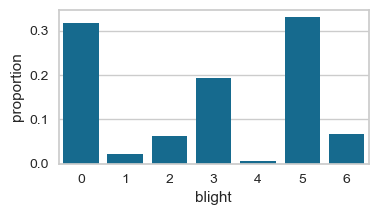

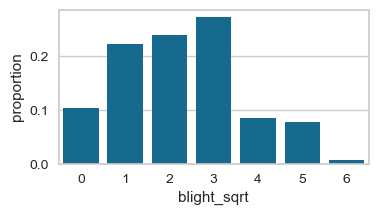

In [7]:
plt.figure(figsize = (4, 2))
sns.barplot(parcels['blight'].value_counts(normalize = True))
plt.show()

plt.figure(figsize = (4, 2))
sns.barplot(parcels['blight_sqrt'].value_counts(normalize = True))
plt.show()

In [29]:
blight_labels = {
    5: 1,
    0: 2,
    2: 3,
    3: 4,
    6: 5,
    1: 6,
    4: 7
}

parcels['blight_'] = parcels['blight'].map(blight_labels)
parcels['blight'] = parcels['blight_']
parcels = parcels.drop(columns = 'blight_')

In [5]:
color_continuous_scale=[
        '#440154', '#443983', '#31688e', '#21918c', '#35b779', '#90d743', '#fde725'
]

fig = px.scatter_mapbox(parcels, lat = 'lat', lon = 'lng', color = 'blight', color_continuous_scale = color_continuous_scale, zoom = 10, hover_data = ['nbrhd'])
fig.update_layout(mapbox_style = 'carto-positron')
fig.show()

In [30]:
sqrt_labels = {
    0: 1,
    2: 2,
    5: 3,
    3: 4,
    1: 5,
    4: 6,
    6: 7
}

parcels['blight_sqrt_'] = parcels['blight_sqrt'].map(sqrt_labels)
parcels['blight_sqrt'] = parcels['blight_sqrt_']
parcels = parcels.drop(columns = 'blight_sqrt_')

In [8]:
color_continuous_scale=[
        '#440154', '#443983', '#31688e', '#21918c', '#35b779', '#90d743', '#fde725'
]

fig = px.scatter_mapbox(parcels, lat = 'lat', lon = 'lng', color = 'blight_sqrt', color_continuous_scale = color_continuous_scale, zoom = 10,
                        hover_data = ['nbrhd'])
fig.update_layout(mapbox_style = 'carto-positron')
fig.show()

### Variable breakdown by cluster

In [31]:
(
    parcels
    .groupby('blight')[['viols_count_decayed', 'low_count_decayed', 'high_count_decayed']].mean()
    .reset_index()
    .rename(columns = {
        'blight': 'Blight',
        'viols_count_decayed': 'Code violations',
        'low_count_decayed': 'Low-sev crimes',
        'high_count_decayed': 'High-sev crimes'
    })
)

,Blight,Code violations,Low-sev crimes,High-sev crimes
0,1,150.72,28.29,16.96
1,2,393.17,65.77,37.96
2,3,392.83,154.04,99.84
3,4,691.79,97.99,55.62
4,5,1335.57,127.34,71.49
5,6,1494.13,264.00,139.19
6,7,244.13,456.69,305.35


In [32]:
(
    parcels
    .groupby('blight_sqrt')[sqrt_cols].mean()
    .reset_index()
    .rename(columns = {
        'blight': 'Blight',
        'viols_sqrt': 'Code violations',
        'low_sqrt': 'Low-sev crimes',
        'high_sqrt': 'High-sev crimes'
    })
)

,blight_sqrt,Code violations,Low-sev crimes,High-sev crimes
0,1,7.87,3.34,2.51
1,2,13.76,5.85,4.51
2,3,18.52,11.51,9.55
3,4,19.81,7.87,5.89
4,5,26.07,9.77,7.36
5,6,36.93,12.88,9.54
6,7,15.36,21.04,17.16


In [33]:
minmax = MinMaxScaler()
parcels['scaled_viols'] = minmax.fit_transform(pd.DataFrame(parcels['viols_count_decayed']))
parcels['scaled_low'] = minmax.fit_transform(pd.DataFrame(parcels['low_count_decayed']))
parcels['scaled_high'] = minmax.fit_transform(pd.DataFrame(parcels['high_count_decayed']))

parcels['scaled_viols_sqrt'] = minmax.fit_transform(pd.DataFrame(parcels['viols_sqrt']))
parcels['scaled_low_sqrt'] = minmax.fit_transform(pd.DataFrame(parcels['low_sqrt']))
parcels['scaled_high_sqrt'] = minmax.fit_transform(pd.DataFrame(parcels['high_sqrt']))

In [34]:
parcels.groupby('blight')[['scaled_viols', 'scaled_low', 'scaled_high']].mean()

,scaled_viols,scaled_low,scaled_high
blight,,,
1,0.08,0.05,0.04
2,0.20,0.11,0.10
3,0.20,0.27,0.25
4,0.35,0.17,0.14
5,0.68,0.22,0.18
6,0.76,0.46,0.35
7,0.12,0.79,0.77


In [35]:
parcels.groupby('blight_sqrt')[['scaled_viols_sqrt', 'scaled_low_sqrt', 'scaled_high_sqrt']].mean()

,scaled_viols_sqrt,scaled_low_sqrt,scaled_high_sqrt
blight_sqrt,,,
1,0.18,0.14,0.13
2,0.31,0.24,0.23
3,0.42,0.48,0.48
4,0.45,0.33,0.30
5,0.59,0.41,0.37
6,0.83,0.54,0.48
7,0.35,0.88,0.86


scaled_viols


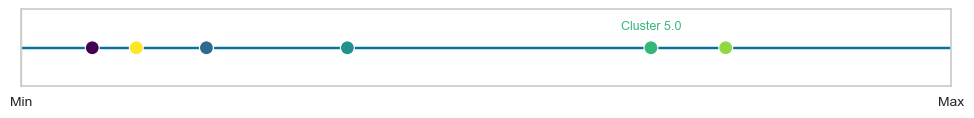

scaled_low


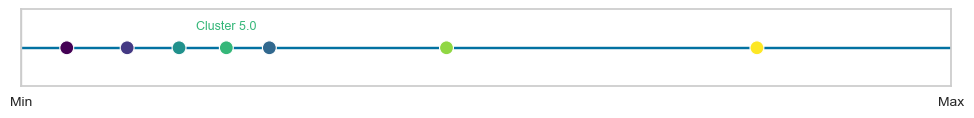

scaled_high


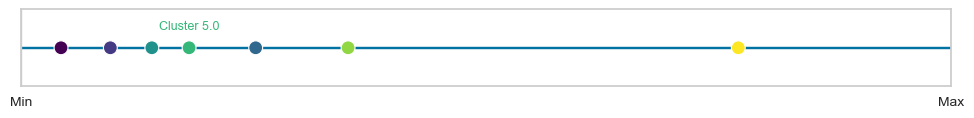

In [36]:
for col in ['scaled_viols', 'scaled_low', 'scaled_high']:
    print(col)
    toPlot = parcels.groupby('blight')[['scaled_viols', 'scaled_low', 'scaled_high']].mean()[col].reset_index().assign(y = 1)

    color_continuous_scale=[
            '#440154', '#443983', '#31688e', '#21918c', '#35b779', '#90d743', '#fde725'
    ]

    plt.figure(figsize = (12, 1))
    sns.scatterplot(data = toPlot, x = col, y = 'y', hue = 'blight', s = 100, palette = color_continuous_scale)
    plt.xlim((0, 1.0))
    plt.xlabel('')
    plt.xticks([0.0, 1.0], ['Min', 'Max'])
    plt.ylim((1.0, 1.0))
    plt.ylabel('')
    plt.yticks([])

    plt.legend([], [])

    plt.axhline(xmin = 0, xmax = 1, y = 1, zorder = 0)

    highlight_cluster = 5
    highlight_data = toPlot[toPlot['blight'] == highlight_cluster]
    for idx, row in highlight_data.iterrows():
        plt.text(
            row[col], row['y'] + 0.02,
            f'Cluster {row['blight']}',
            ha = 'center', va = 'bottom', fontsize = 9,
            color = color_continuous_scale[int(row['blight'] - 1)]
        )

    plt.show()

scaled_viols_sqrt


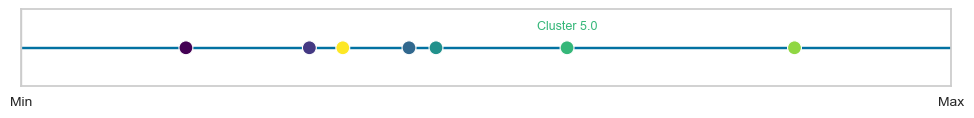

scaled_low_sqrt


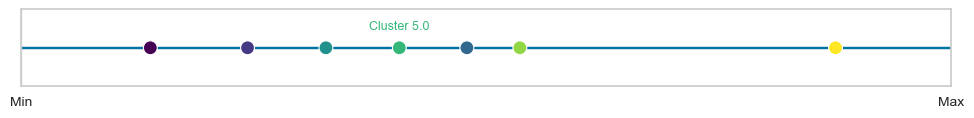

scaled_high_sqrt


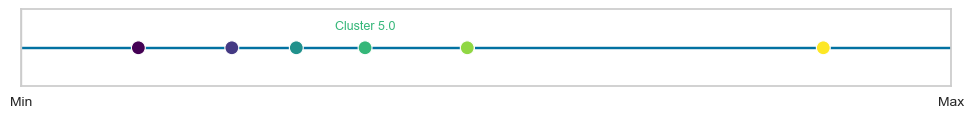

In [37]:
for col in ['scaled_viols_sqrt', 'scaled_low_sqrt', 'scaled_high_sqrt']:
    print(col)
    toPlot = parcels.groupby('blight_sqrt')[['scaled_viols_sqrt', 'scaled_low_sqrt', 'scaled_high_sqrt']].mean()[col].reset_index().assign(y = 1)

    color_continuous_scale=[
            '#440154', '#443983', '#31688e', '#21918c', '#35b779', '#90d743', '#fde725'
    ]

    plt.figure(figsize = (12, 1))
    sns.scatterplot(data = toPlot, x = col, y = 'y', hue = 'blight_sqrt', s = 100, palette = color_continuous_scale)
    plt.xlim((0, 1.0))
    plt.xlabel('')
    plt.xticks([0.0, 1.0], ['Min', 'Max'])
    plt.ylim((1.0, 1.0))
    plt.ylabel('')
    plt.yticks([])

    plt.legend([], [])

    plt.axhline(xmin = 0, xmax = 1, y = 1, zorder = 0)

    highlight_cluster = 5
    highlight_data = toPlot[toPlot['blight_sqrt'] == highlight_cluster]
    for idx, row in highlight_data.iterrows():
        plt.text(
            row[col], row['y'] + 0.02,
            f'Cluster {row['blight_sqrt']}',
            ha = 'center', va = 'bottom', fontsize = 9,
            color = color_continuous_scale[int(row['blight_sqrt'] - 1)]
        )

    plt.show()

Property Code Violations


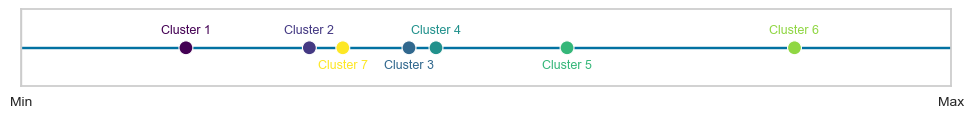

Low-Severity Crime Incidents


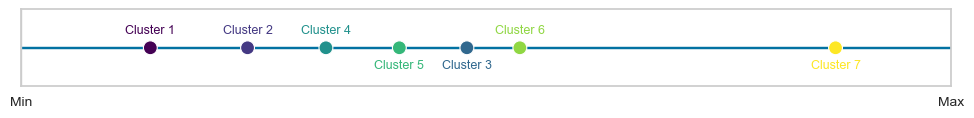

High-Severity Crime Incidents


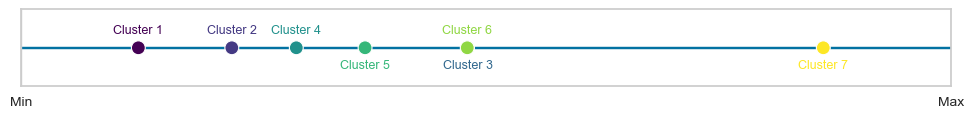

In [38]:
for col, name in zip(['scaled_viols_sqrt', 'scaled_low_sqrt', 'scaled_high_sqrt'], ['Property Code Violations', 'Low-Severity Crime Incidents', 'High-Severity Crime Incidents']):
    print(name)
    toPlot = (
        parcels.groupby('blight_sqrt')[['scaled_viols_sqrt', 'scaled_low_sqrt', 'scaled_high_sqrt']]
        .mean()[col]
        .reset_index()
        .assign(y=1)
    )

    color_continuous_scale = [
        '#440154', '#443983', '#31688e', '#21918c', '#35b779', '#90d743', '#fde725'
    ]

    plt.figure(figsize=(12, 1))
    sns.scatterplot(
        data=toPlot,
        x=col, y='y',
        hue='blight_sqrt',
        s=100,
        palette=color_continuous_scale
    )
    plt.xlim((0, 1.0))
    plt.xlabel('')
    plt.xticks([0.0, 1.0], ['Min', 'Max'])
    plt.ylim((0.9, 1.1))
    plt.ylabel('')
    plt.yticks([])

    plt.legend([], [])  # optional

    plt.axhline(xmin=0, xmax=1, y=1, zorder=0)

    # offsets: positive = above, negative = below
    offsets = {
        1: +0.03,
        2: +0.03,
        3: -0.03,  # flip cluster 3 below
        4: +0.03,
        5: -0.03,  # flip cluster 5 below
        6: +0.03,
        7: -0.03
    }

    # Annotate with offsets
    for idx, row in toPlot.iterrows():
        cluster = int(row['blight_sqrt'])
        plt.text(
            row[col],
            row['y'] + offsets.get(cluster, 0.03),  # default offset if not in dict
            f'Cluster {cluster}',
            ha='center', va='bottom' if offsets.get(cluster, 0.03) > 0 else 'top',
            fontsize=9,
            color=color_continuous_scale[cluster - 1]
        )

    plt.show()

In [22]:
parcels

,parcelID,lat,lng,nbrhd,tract,block,geoID,viols_count_decayed,viols_log,viols_sqrt,viols_bin_7,viols_cluster_7,viols_cluster_7_sqrt,low_count_decayed,low_log,low_sqrt,low_bin_7,low_cluster_7,low_cluster_7_sqrt,high_count_decayed,high_log,high_sqrt,high_bin_7,high_cluster_7,high_cluster_7_sqrt,blight,blight_sqrt
0,0001D00023005A00,40.44,-80.00,Central Business District,20100,2019,420030201002019,251.60,5.53,15.86,3,2,3,472.41,6.16,21.73,7,7,7,329.26,5.80,18.15,7,7,7,7,7
1,0088C00010000000,40.42,-79.92,Squirrel Hill South,141400,1000,420031414001000,278.87,5.63,16.70,3,2,3,34.18,3.53,5.85,2,1,2,21.95,3.09,4.68,2,1,2,1,2
2,0055P00349000000,40.42,-79.94,Hazelwood,562900,3019,420035629003019,376.73,5.93,19.41,4,3,4,31.07,3.44,5.57,2,1,2,17.27,2.85,4.16,2,1,2,2,2
3,0049R00041000000,40.46,-79.96,Bloomfield,90300,2003,420030903002003,530.53,6.27,23.03,5,4,5,118.05,4.77,10.86,6,4,5,53.08,3.97,7.29,5,3,4,4,5
4,0014M00121000000,40.42,-79.98,Mt. Oliver,481000,1001,420034810001001,575.00,6.35,23.98,6,4,5,75.91,4.33,8.71,5,3,4,37.85,3.63,6.15,4,2,3,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144026,0087C00234000000,40.43,-79.92,Squirrel Hill South,140800,2011,420031408002011,522.73,6.26,22.86,5,4,5,95.01,4.55,9.75,6,3,5,57.36,4.05,7.57,6,3,4,4,5
144027,0075G00057000000,40.48,-80.04,Brighton Heights,270300,2001,420032703002001,275.73,5.62,16.61,3,2,3,77.18,4.35,8.79,5,3,4,38.39,3.65,6.20,4,2,3,2,4
144028,0013H00179000000,40.42,-79.97,South Side Slopes,160800,3001,420031608003001,1129.00,7.03,33.60,7,6,6,57.85,4.06,7.61,4,2,3,36.21,3.59,6.02,4,2,3,5,5
144029,0047J00201000000,40.46,-80.00,Spring Hill-City View,262000,1016,420032620001016,270.00,5.60,16.43,3,2,3,44.60,3.80,6.68,3,2,3,28.90,3.36,5.38,3,2,3,1,2


In [23]:
parcels.loc[parcels['blight_sqrt'] == 6]['nbrhd'].value_counts(normalize = True)

nbrhd
South Side Flats    0.24
South Side Slopes   0.15
Homewood North      0.12
Allentown           0.12
Knoxville           0.11
Central Oakland     0.07
Homewood South      0.07
South Oakland       0.06
Beltzhoover         0.04
Mount Washington    0.02
Mt. Oliver          0.00
Homewood West       0.00
Arlington Heights   0.00
Name: proportion, dtype: float64

In [24]:
parcels.loc[parcels['blight_sqrt'] == 5]['nbrhd'].value_counts(normalize = True)

nbrhd
Mount Washington        0.07
Bloomfield              0.07
Garfield                0.06
Hazelwood               0.05
Middle Hill             0.05
                        ... 
Point Breeze North      0.00
Polish Hill             0.00
Crawford-Roberts        0.00
North Oakland           0.00
Spring Hill-City View   0.00
Name: proportion, Length: 53, dtype: float64

In [26]:
parcels.loc[parcels['nbrhd'] == 'East Liberty']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
3   0.72
5   0.22
4   0.05
Name: proportion, dtype: float64

In [27]:
parcels.loc[parcels['nbrhd'] == 'Squirrel Hill North']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
2   0.70
4   0.17
1   0.11
3   0.02
Name: proportion, dtype: float64

In [28]:
parcels.loc[parcels['nbrhd'] == 'Lincoln-Lemington-Belmar']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
4   0.43
5   0.33
2   0.18
1   0.06
Name: proportion, dtype: float64

In [29]:
parcels.loc[parcels['nbrhd'] == 'Homewood West']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
5   0.77
4   0.13
6   0.06
3   0.04
Name: proportion, dtype: float64

In [30]:
parcels.loc[parcels['nbrhd'] == 'Hays']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
1   1.00
Name: proportion, dtype: float64

In [25]:
parcels.loc[parcels['nbrhd'] == 'Shadyside']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
3   0.60
2   0.22
4   0.18
Name: proportion, dtype: float64

In [31]:
parcels.loc[parcels['nbrhd'] == 'South Oakland']['blight_sqrt'].value_counts(normalize = True)

blight_sqrt
6   0.44
5   0.41
4   0.13
2   0.01
Name: proportion, dtype: float64

In [18]:
parcels.to_csv(clean + 'blight.csv', index = False)

In [7]:
parcels = pd.read_csv(clean + 'blight.csv')